In [1]:
import spateo as st
import dynamo as dyn
import numpy as np
import plotly.express as px

from matplotlib import pyplot as plt

2023-10-11 19:32:21.621281: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-10-11 19:32:21.677368: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-10-11 19:32:22.315607: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/libpysal/cg/alpha_shapes.py:39: NumbaDeprecationWarning:

The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is cur

In [2]:
# Load annotated binning data
fname_bin60 = "mousebrain_bin60_clustered.h5ad"
adata_bin60 = st.sample_data.mousebrain(fname_bin60)

# Load higher resolution binning data (optional)
fname_bin30 = "mousebrain_bin30.h5ad"
adata_bin30 = st.sample_data.mousebrain(fname_bin30)

adata_bin60, adata_bin30

|-----> Downloading data to ./data/mousebrain_bin60_clustered.h5ad
|-----> Downloading data to ./data/mousebrain_bin30.h5ad


(AnnData object with n_obs × n_vars = 7765 × 21667
     obs: 'area', 'n_counts', 'Size_Factor', 'initial_cell_size', 'louvain', 'scc', 'scc_anno'
     var: 'pass_basic_filter'
     uns: '__type', 'louvain', 'louvain_colors', 'neighbors', 'pp', 'scc', 'scc_anno_colors', 'scc_colors', 'spatial', 'spatial_neighbors'
     obsm: 'X_pca', 'X_spatial', 'bbox', 'contour', 'spatial'
     layers: 'count', 'spliced', 'unspliced'
     obsp: 'connectivities', 'distances', 'spatial_connectivities', 'spatial_distances',
 AnnData object with n_obs × n_vars = 31040 × 25691
     obs: 'area'
     uns: '__type', 'pp', 'spatial'
     obsm: 'X_spatial', 'bbox', 'contour', 'spatial'
     layers: 'count', 'spliced', 'unspliced')

# Extract region of interest

In [3]:
# Extract spatial domains from SCC clusters.
# Transfer domain annotation to higher resolution anndata object for better visualization (optional).
st.dd.set_domains(
    adata_high_res=adata_bin30,
    adata_low_res=adata_bin60,
    bin_size_high=30,
    bin_size_low=60,
    cluster_key="scc_anno",
    k_size=1.8,
    min_area=16,
)

|-----> Generate the cluster label image with `gen_cluster_image`.
|-----> Set up the color for the clusters with the tab20 colormap.
|-----> Saving integer labels for clusters into adata.obs['cluster_img_label'].
|-----> Prepare a mask image and assign each pixel to the corresponding cluster id.
|-----> Iterate through each cluster and identify contours with `extract_cluster_contours`.
|-----> Get selected areas with label id(s): 13.


/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:67: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:67: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:67: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp

|-----> Close morphology of the area formed by cluster 13.
|-----> Remove small region(s).
|-----> Extract contours.


/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/m

|-----> Get selected areas with label id(s): 7.
|-----> Close morphology of the area formed by cluster 7.


/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/m

|-----> Remove small region(s).
|-----> Extract contours.


/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/m

|-----> Get selected areas with label id(s): 5.


/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/m

|-----> Close morphology of the area formed by cluster 5.
|-----> Remove small region(s).
|-----> Extract contours.


/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/m

|-----> Get selected areas with label id(s): 1.
|-----> Close morphology of the area formed by cluster 1.


/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/m

|-----> Remove small region(s).
|-----> Extract contours.


/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/m

|-----> Get selected areas with label id(s): 12.


/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/m

|-----> Close morphology of the area formed by cluster 12.
|-----> Remove small region(s).
|-----> Extract contours.


/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/m

|-----> Get selected areas with label id(s): 9.


/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/m

|-----> Close morphology of the area formed by cluster 9.
|-----> Remove small region(s).
|-----> Extract contours.


/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/m

|-----> Get selected areas with label id(s): 6.


/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/m

|-----> Close morphology of the area formed by cluster 6.
|-----> Remove small region(s).
|-----> Extract contours.


/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/m

|-----> Get selected areas with label id(s): 8.
|-----> Close morphology of the area formed by cluster 8.


/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/m

|-----> Remove small region(s).
|-----> Extract contours.


/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/m

|-----> Get selected areas with label id(s): 10.
|-----> Close morphology of the area formed by cluster 10.


/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/m

|-----> Remove small region(s).
|-----> Extract contours.


/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/m

|-----> Get selected areas with label id(s): 17.


/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/m

|-----> Close morphology of the area formed by cluster 17.
|-----> Remove small region(s).
|-----> Extract contours.


/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/m

|-----> Get selected areas with label id(s): 3.


/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/m

|-----> Close morphology of the area formed by cluster 3.
|-----> Remove small region(s).
|-----> Extract contours.


/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/m

|-----> Get selected areas with label id(s): 15.
|-----> Close morphology of the area formed by cluster 15.
|-----> Remove small region(s).
|-----> Extract contours.


/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/m

|-----> Get selected areas with label id(s): 11.
|-----> Close morphology of the area formed by cluster 11.
|-----> Remove small region(s).
|-----> Extract contours.


/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/m

|-----> Get selected areas with label id(s): 14.


/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/m

|-----> Close morphology of the area formed by cluster 14.
|-----> Remove small region(s).
|-----> Extract contours.


/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/m

|-----> Get selected areas with label id(s): 4.


/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/m

|-----> Close morphology of the area formed by cluster 4.
|-----> Remove small region(s).
|-----> Extract contours.


/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/m

|-----> Get selected areas with label id(s): 2.


/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/m

|-----> Close morphology of the area formed by cluster 2.
|-----> Remove small region(s).
|-----> Extract contours.
|-----> Get selected areas with label id(s): 16.


/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/m

|-----> Close morphology of the area formed by cluster 16.
|-----> Remove small region(s).
|-----> Extract contours.


/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/m

|-----> Get selected areas with label id(s): 18.
|-----> Close morphology of the area formed by cluster 18.
|-----> Remove small region(s).
|-----> Extract contours.


/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:235: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/m

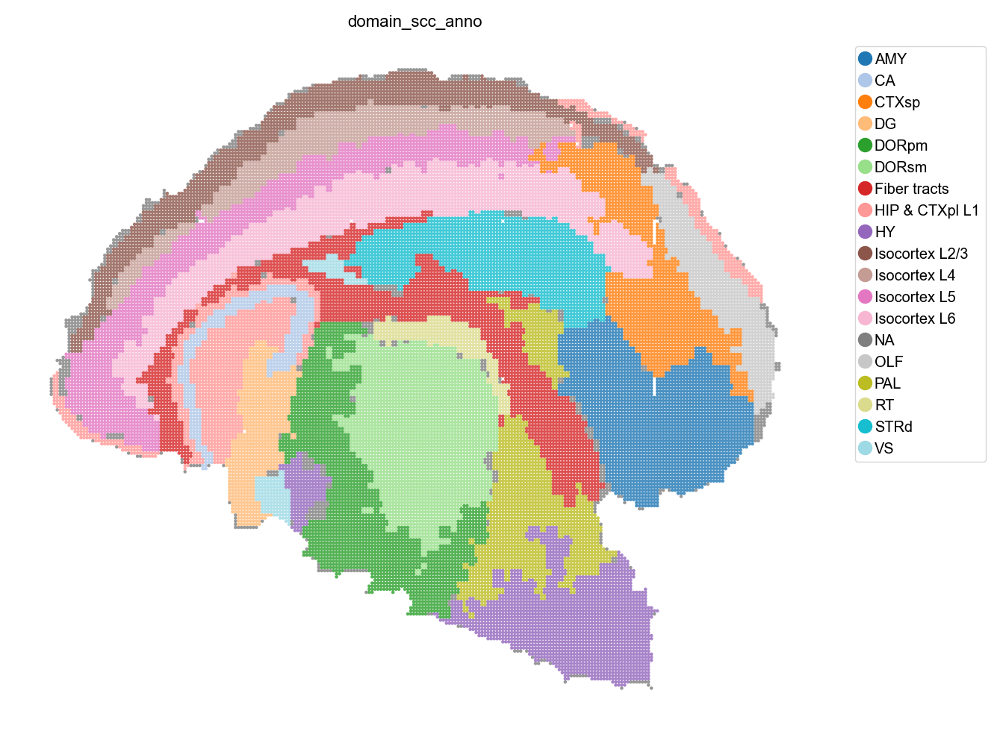

In [4]:
# Visualize transfered spatial domain
st.pl.space(
    adata_bin30,
    color=['domain_scc_anno'],
    show_legend="upper left",
    figsize=(8, 6),
    color_key_cmap="tab20",
)

In [5]:
adata_bin30.obs

,area,domain_scc_anno
10-100,900,Isocortex L5
10-101,900,Isocortex L5
10-102,900,Isocortex L5
10-103,900,Isocortex L5
10-104,900,NA
...,...,...
99-95,900,DORpm
99-96,900,DORpm
99-97,900,DORpm
99-98,900,DORpm


In [6]:
adata_bin30

AnnData object with n_obs × n_vars = 31040 × 25691
    obs: 'area', 'domain_scc_anno'
    uns: '__type', 'pp', 'spatial', 'domain_scc_anno_colors'
    obsm: 'X_spatial', 'bbox', 'contour', 'spatial'
    layers: 'count', 'spliced', 'unspliced'

In [7]:
# Generate matrix/image of spatial clusters with distinct labels/colors

adata_bin30.obsm['spatial_bin30'] = adata_bin30.obsm['spatial']//30
cluster_label_image_lowres = st.dd.gen_cluster_image(
    adata_bin30, bin_size=1, spatial_key="spatial_bin30", cluster_key='domain_scc_anno', show=False)

|-----> Set up the color for the clusters with the tab20 colormap.
|-----> Saving integer labels for clusters into adata.obs['cluster_img_label'].
|-----> Prepare a mask image and assign each pixel to the corresponding cluster id.


/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:67: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:67: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/contour.py:67: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp

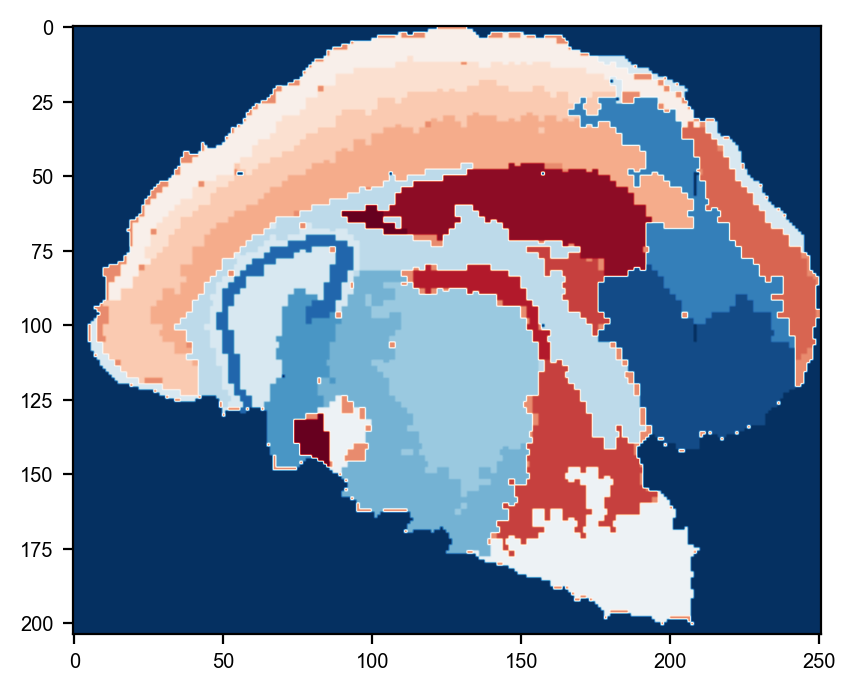

In [8]:
plt.imshow(cluster_label_image_lowres.T[::-1])
plt.show()

In [9]:
set(cluster_label_image_lowres.flatten())

{0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19}

In [10]:
adata_bin30.obs['domain_scc_anno'].value_counts()

domain_scc_anno
Isocortex L6      2771
DORsm             2628
Fiber tracts      2592
AMY               2455
Isocortex L5      2316
DORpm             2263
HY                2065
STRd              1853
Isocortex L2/3    1819
CTXsp             1732
PAL               1730
HIP & CTXpl L1    1633
Isocortex L4      1408
OLF                966
NA                 876
DG                 810
CA                 496
RT                 386
VS                 241
Name: count, dtype: int64

|-----> Get selected areas with label id(s): [11 12].
|-----> Close morphology of the area formed by cluster [11 12].
|-----> Remove small region(s).
|-----> Extract contours.


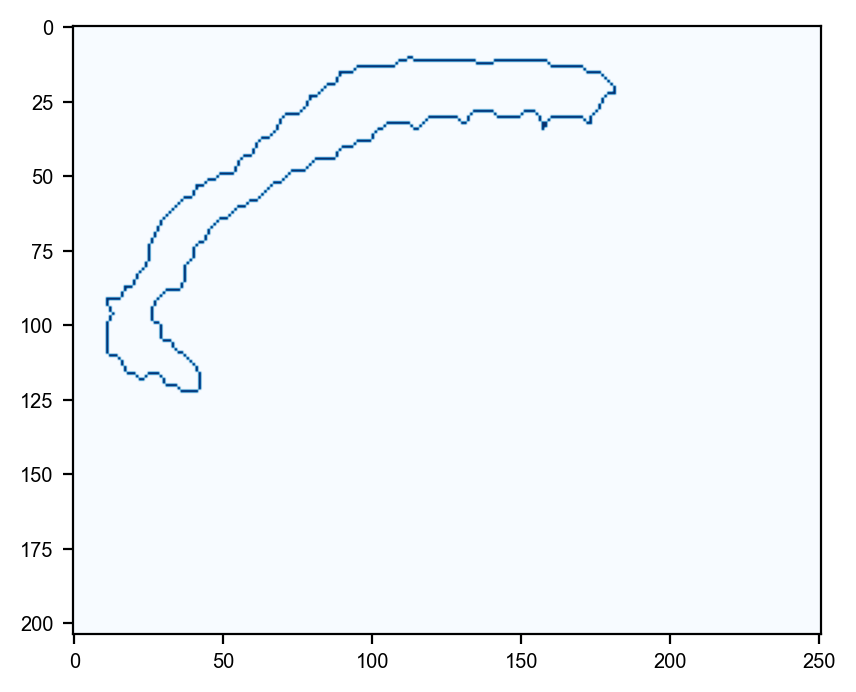

In [27]:
cluster_label_list = np.unique(adata_bin30[adata_bin30.obs['domain_scc_anno'].isin(['Isocortex L4','Isocortex L5']), :].obs["cluster_img_label"])
contours, cluster_image_close, cluster_image_contour = st.dd.extract_cluster_contours(
    cluster_label_image_lowres, cluster_label_list, bin_size=1, k_size=6, show=False)

# px.imshow(cluster_image_contour, width=500, height=500)
plt.imshow(cluster_image_contour.T[::-1], cmap='Blues')
plt.show()

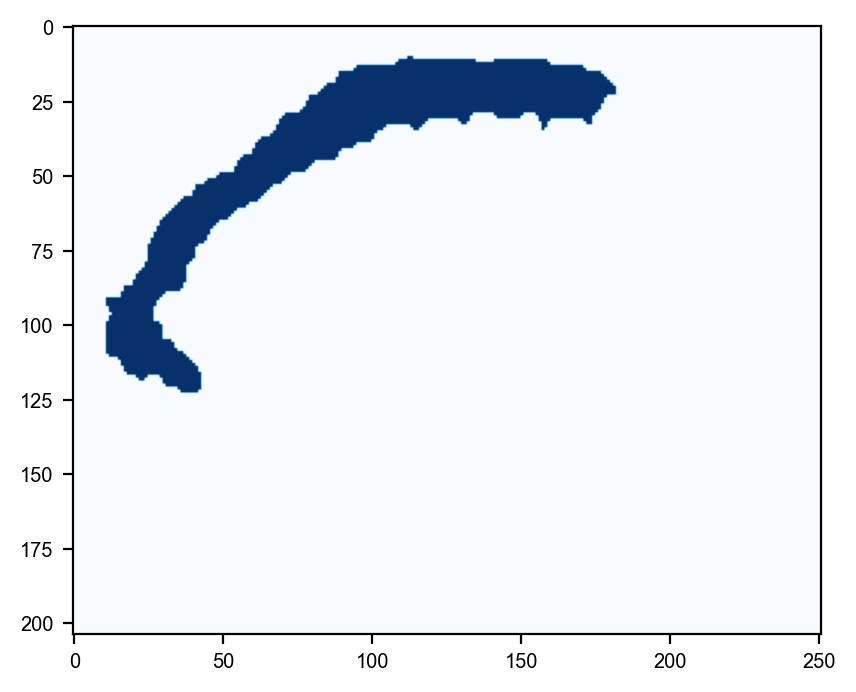

In [31]:
plt.imshow(cluster_image_close.T[::-1], cmap='Blues')

In [33]:
px.imshow(cluster_image_contour, width=500, height=500)

In [32]:
cluster_label_list

array([11, 12])

# Digitize the region of interest

In [14]:
# User input to specify a gridding direction
pnt_xY = (82,35)
pnt_xy = (91,39)
pnt_Xy = (171,172)
pnt_XY = (182,181)

# Digitize the area of interest
st.dd.digitize(
    adata=adata_bin30,
    ctrs=contours,  # 轮廓的坐标
    ctr_idx=0,
    pnt_xy=pnt_xy,
    pnt_xY=pnt_xY,
    pnt_Xy=pnt_Xy,
    pnt_XY=pnt_XY,
    spatial_key="spatial_bin30"
)

|-----> Initialize the field of the spatial domain of interests.
|-----> Prepare the isoline segments with either the highest/lower column or layer heat values.
|-----> Solve the layer heat equation on spatial domain with the iso-layer-line conditions.
|-----> Total iteration: 890
|-----> Saving layer heat values to digital_layer.
10-100    0.0
10-101    0.0
10-102    0.0
10-103    0.0
10-104    0.0
         ... 
99-95     0.0
99-96     0.0
99-97     0.0
99-98     0.0
99-99     0.0
Name: digital_layer, Length: 31040, dtype: float64
|-----> Solve the column heat equation on spatial domain with the iso-column-line conditions.


/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/grid.py:87: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/grid.py:87: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/grid.py:87: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambafor

|-----> Total iteration: 924
|-----> Saving column heat values to digital_column.


/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/grid.py:106: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/grid.py:106: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/spateo/digitization/grid.py:106: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mamba

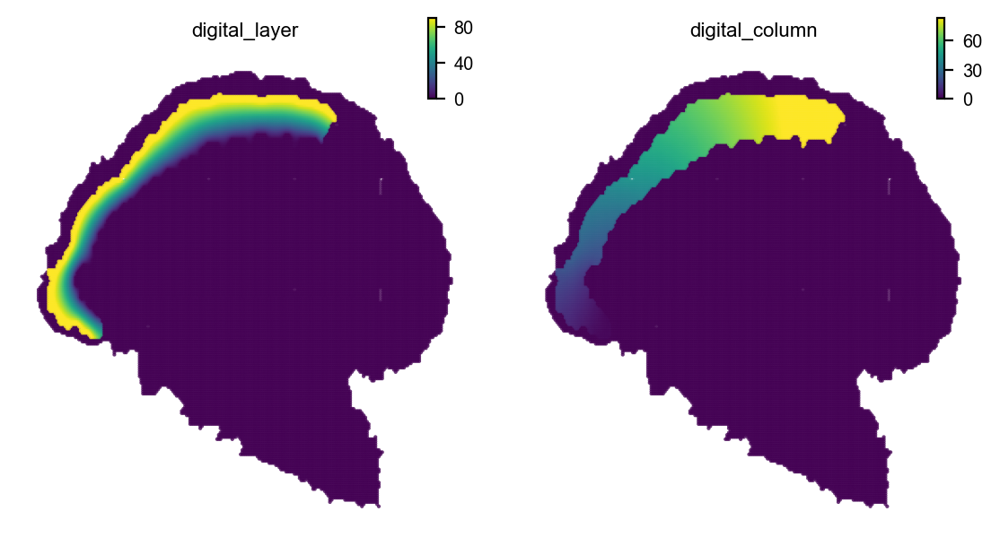

In [15]:
# Visualize digitized layers and columns
st.pl.space(
    adata_bin30,
    color=['digital_layer', 'digital_column'],
    ncols=2,
    pointsize=0.1,
    show_legend="upper left",
    figsize=(4, 3.5),
    color_key_cmap = "tab20",
)

# Identify variable genes along digitized columns with GLM

In [16]:
# Bin the digitized columns into larger columns
adata_bin30_l4l5 = adata_bin30[adata_bin30.obs['digital_column']!=0].copy()
adata_bin30_l4l5.obs['binned_column'] = adata_bin30_l4l5.obs['digital_column']//4

# Filter out low expressed genes and calculate GLM regression for each gene
st.pp.filter.filter_genes(adata_bin30_l4l5, min_cells=adata_bin30_l4l5.n_obs*0.05, inplace=True)
dyn.pp.normalize_cell_expr_by_size_factors(adata_bin30_l4l5)
dyn.tl.glm_degs(adata_bin30_l4l5, fullModelFormulaStr='~binned_column')

|-----> Set <adata.X> to normalized data
|-----? `total_szfactor` is not `None` and it is not in adata object.


/tmp/ipykernel_1976077/611207395.py:7: DeprecationWarning:

normalize_cell_expr_by_size_factors is deprecated and will be removed in a future release. Please update your code to use the new replacement function.

Detecting time dependent genes via Generalized Additive Models (GAMs): 0it [00:00, ?it/s]/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/dynamo/tools/markers.py:710: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/statsmodels/genmod/families/family.py:1367: ValueWarning:

Negative binomial dispersion parameter alpha not set. Using default value alpha=1.0.

/home/mowp/mambaforge/envs/spateo/lib/python3.9/site-packages/dynamo/tools/markers.py:710: SettingWithCopyWarn

In [38]:
adata_bin30_l4l5.obs

,area,domain_scc_anno,cluster_img_label,digital_layer,digital_column,binned_column,count_Size_Factor,initial_count_cell_size,spliced_Size_Factor,initial_spliced_cell_size,Size_Factor,initial_cell_size,unspliced_Size_Factor,initial_unspliced_cell_size
100-166,900,Isocortex L6,13,1.000000,58.705882,14.0,0.899384,438.0,0.979798,194,0.899384,438.0,0.865248,244
100-167,900,Isocortex L6,13,1.000000,59.235294,14.0,1.123203,547.0,0.888889,176,1.123203,547.0,1.315603,371
100-168,900,Isocortex L5,12,4.460611,59.411294,14.0,1.135524,553.0,1.070707,212,1.135524,553.0,1.209220,341
100-169,900,Isocortex L5,12,8.320813,59.655674,14.0,0.363450,177.0,0.479798,95,0.363450,177.0,0.290780,82
100-170,900,Isocortex L5,12,12.595067,59.939815,14.0,0.392197,191.0,0.348485,69,0.392197,191.0,0.432624,122
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99-186,900,Isocortex L4,11,84.799798,64.783588,16.0,1.117043,544.0,1.010101,200,1.117043,544.0,1.219858,344
99-187,900,Isocortex L4,11,88.699818,65.106049,16.0,1.078029,525.0,1.045455,207,1.078029,525.0,1.127660,318
99-188,900,Isocortex L4,11,92.524589,65.423663,16.0,1.402464,683.0,1.348485,267,1.402464,683.0,1.475177,416
99-189,900,Isocortex L4,11,96.282684,65.736165,16.0,1.234086,601.0,1.151515,228,1.234086,601.0,1.322695,373


In [41]:
adata_bin30_l4l5

AnnData object with n_obs × n_vars = 3851 × 1512
    obs: 'area', 'domain_scc_anno', 'cluster_img_label', 'digital_layer', 'digital_column', 'binned_column', 'count_Size_Factor', 'initial_count_cell_size', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'Size_Factor', 'initial_cell_size', 'unspliced_Size_Factor', 'initial_unspliced_cell_size'
    var: 'pass_basic_filter'
    uns: '__type', 'pp', 'spatial', 'domain_scc_anno_colors', 'glm_degs'
    obsm: 'X_spatial', 'bbox', 'contour', 'spatial', 'spatial_bin30'
    layers: 'count', 'spliced', 'unspliced', 'X_spliced', 'X_count', 'X_unspliced'

In [43]:
df

,status,family,pval,qval,pos_rate,gene
Tshz2,ok,NB2,0.000000e+00,0.0,0.079979,Tshz2
Negr1,ok,NB2,3.871612e-32,0.0,0.434692,Negr1
Rorb,ok,NB2,2.352456e-26,0.0,0.179174,Rorb
Fam19a2,ok,NB2,1.047477e-23,0.0,0.226954,Fam19a2
Unc5d,ok,NB2,1.268598e-19,0.0,0.274734,Unc5d
...,...,...,...,...,...,...
Atp11b,ok,NB2,9.967345e-01,0.998233,0.053752,Atp11b
Ksr2,ok,NB2,9.967536e-01,0.998233,0.112958,Ksr2
Atxn10,ok,NB2,9.969130e-01,0.998233,0.052714,Atxn10
Fnbp1,ok,NB2,9.981344e-01,0.998493,0.078162,Fnbp1


In [17]:
# Create result dataframe
df = adata_bin30_l4l5.uns['glm_degs'].copy()
df = df.sort_values('pval',ascending=True)

df['pos_rate'] = 0.0
for i in df.index.to_list():
    df['pos_rate'][i] = np.sum(adata_bin30_l4l5[:,i].X.A != 0) / len(adata_bin30_l4l5[:,i].X.A)  # 计算每个基因的表达率, 也就是每个基因在多少个细胞中有表达
df['gene'] = df.index.to_list()
df['pval'] = df['pval'].astype(np.float32)
df.loc[np.logical_and(df['pval']<0.05, df['pos_rate']>0.2),:].head(10)

/tmp/ipykernel_1976077/3647453391.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_1976077/3647453391.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_1976077/3647453391.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_1976077/3647453391.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pa

,status,family,pval,qval,pos_rate,gene
Negr1,ok,NB2,3.871612e-32,0.0,0.434692,Negr1
Fam19a2,ok,NB2,1.047477e-23,0.0,0.226954,Fam19a2
Unc5d,ok,NB2,1.268598e-19,0.0,0.274734,Unc5d
Gm21949,ok,NB2,6.985123e-16,0.0,0.288237,Gm21949
Prkg1,ok,NB2,4.592912e-15,0.0,0.202285,Prkg1
Lingo2,ok,NB2,6.843934e-15,0.0,0.429499,Lingo2
Gm28928,ok,NB2,5.692349e-11,0.0,0.411062,Gm28928
Rims1,ok,NB2,1.241717e-10,0.0,0.379901,Rims1
Nrg1,ok,NB2,1.864342e-10,0.0,0.548169,Nrg1
Erc2,ok,NB2,2.929165e-10,0.0,0.387432,Erc2


|-----? `total_szfactor` is not `None` and it is not in adata object.


/tmp/ipykernel_1976077/3852092806.py:3: DeprecationWarning:

normalize_cell_expr_by_size_factors is deprecated and will be removed in a future release. Please update your code to use the new replacement function.



|-----> Set <adata.X> to normalized data


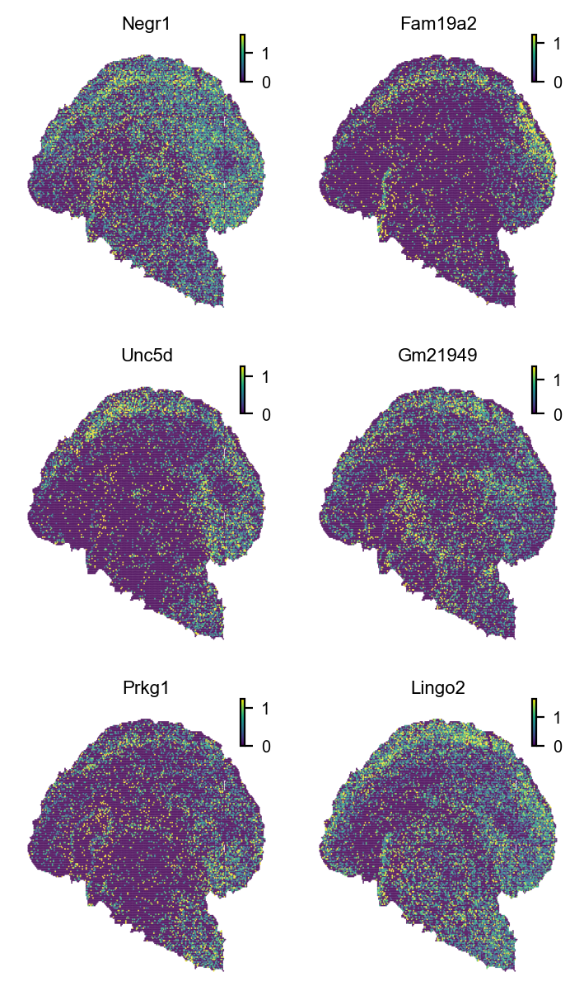

In [48]:
# Visualize column-variable genes
adata_bin30.X = adata_bin30.layers['count'].copy()
dyn.pp.normalize_cell_expr_by_size_factors(adata_bin30)
st.pl.space(
    adata_bin30,
    genes=df.loc[np.logical_and(df['pval']<0.05, df['pos_rate']>0.2),:].index.to_list()[0:6],
    ncols=2,
    pointsize=0.02,
    figsize=(2.5, 2.5),
    cmap="viridis",
    show_legend="upper left",
    save_show_or_return='show')